# NHÓM 26

# Required Packages

In [23]:
import os # to read image from file location system
import tensorflow as tf
import numpy as np # version 1.24.2
import cv2 # version 4.8.1
import matplotlib.pyplot as plt #version 3.8.2
from IPython.display import Image
from skimage.metrics import structural_similarity as ssim #version 0.22.0

# METRICS

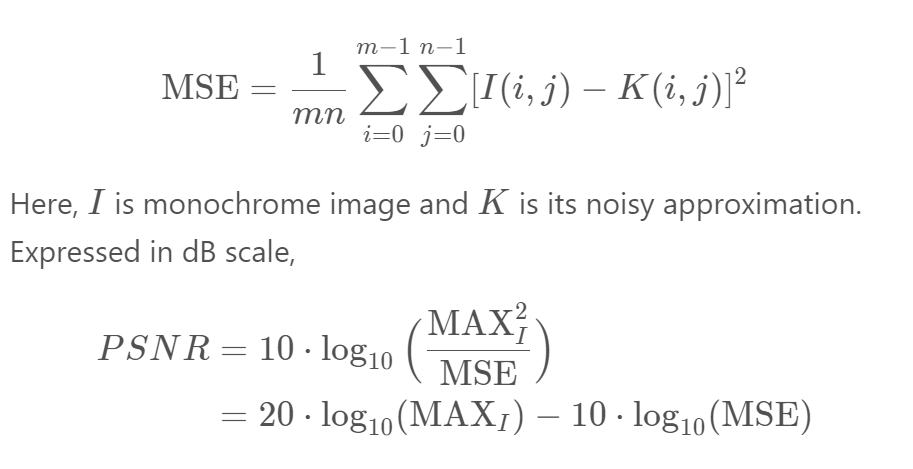

In [2]:
Image(filename='./metric.png')  # Metric to evaluate quality of training dataset

- Chỉ số MSE (Loss) càng cao thì độ tương đồng giữa 2 bức ảnh càng ít
- Chỉ số PSNR càng cao thì độ tương đồng giữa 2 bức ảnh là nhiều
- --> mong muốn tăng PSNR và giảm loss MSE

In [24]:
def psnr(target, ref):
    # Assume target is RGB/BGR image
    target_data = target.astype(np.float32)
    ref_data = ref.astype(np.float32)
    
    diff = ref_data - target_data
    diff = diff.flatten('C') # flatten image = row
    
    rmse = np.sqrt(np.mean(diff ** 2.)) # root mean square error
    
    return 20 * np.log10(255. / rmse)

In [25]:
def mse(target, ref): # Peak Signal-to-Noise Ratio (PSNR) using the RMSE value
    target_data = target.astype(np.float32)
    ref_data = ref.astype(np.float32)
    err = np.sum((target_data - ref_data) ** 2)
    
    err /= np.float32(target_data.shape[0] * target_data.shape[1])
    return err

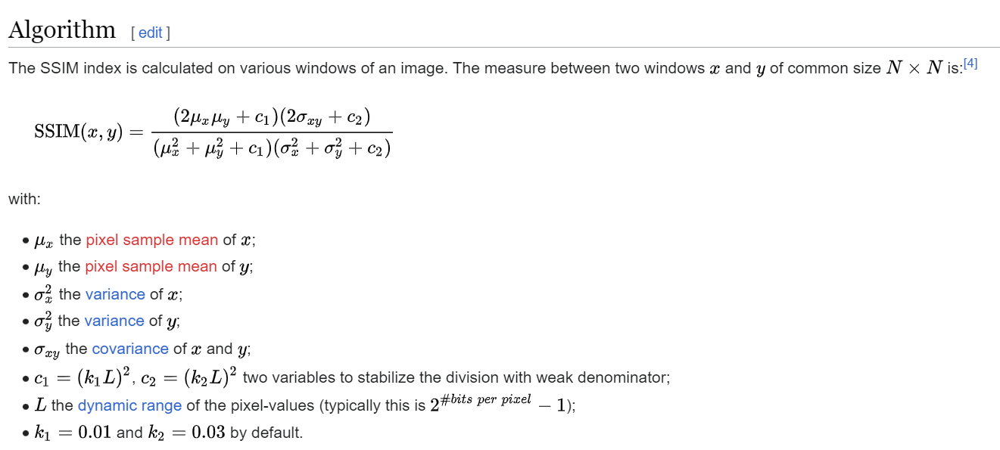

In [5]:
Image(filename='./ssim_metric.png')

- Chỉ số SSIM càng gần 1 thì mức độ tương đồng giữa 2 bức ảnh càng cao --> mô hình học càng tốt

In [26]:
# Function to compute SSIM between two color images
def compare_color_images(image1, image2):
    # Normalize pixel values to the range [0, 1]
    image1 = image1.astype(np.float32) / 255.0
    image2 = image2.astype(np.float32) / 255.0
    # Ensure that the images have the same size
    image2 = cv2.resize(image2, (image1.shape[1], image1.shape[0]))
    # Convert the images to the YCbCr color space
    img1_ycbcr = cv2.cvtColor(image1, cv2.COLOR_BGR2YCrCb)
    img2_ycbcr = cv2.cvtColor(image2, cv2.COLOR_BGR2YCrCb)
    # data_range = 1.0 if image1.dtype == np.float32 else 255.0
    # Extract the luminance component (Y channel)
    y1 = img1_ycbcr[:, :, 0]
    y2 = img2_ycbcr[:, :, 0]

    # Compute SSIM
    ssim_index, _ = ssim(y1, y2, full=True, data_range=255)
    return ssim_index

In [27]:
def compare_images(target, ref):
    scores = []
    scores.append(psnr(target, ref))
    scores.append(mse(target, ref))
    scores.append(compare_color_images(target, ref))
    return scores

# DATA PREPROCESSING

- Làm mờ hình ảnh bằng cách down scaling ( giảm kích thước đi 'factor' lần)
- Sau đó up scaling lại hình ảnh ( tăng kích thước lên 'fator' lần)
- **Thu được ảnh resized sẽ mờ hơn ảnh gốc từ đó làm dữ liệu cho tập Train**

In [29]:
def prepare_images(path, factor): # resized image
    # Loop through the files in the directory
    for file in os.listdir(path):
        image = cv2.imread(path + '/' + file)

        # Find old and new image dimensions
        h, w, c = image.shape
        new_height = int(h / factor)
        new_width = int(w / factor)
        
        # Resize down the image
        image = cv2.resize(image, (new_width, new_height), interpolation=cv2.INTER_LINEAR)
        
        # Resize up the image
        image = cv2.resize(image, (w, h), interpolation=cv2.INTER_LINEAR)
        
        # Save the image
        try:
            os.listdir(path + '/../../resized')
        except:
            os.mkdir(path + '/../../resized')
            
        cv2.imwrite(path + '/../../resized/{}'.format(file), image)


prepare_images('./dataset/SRCNN_dataset/Test/Set14', 3)

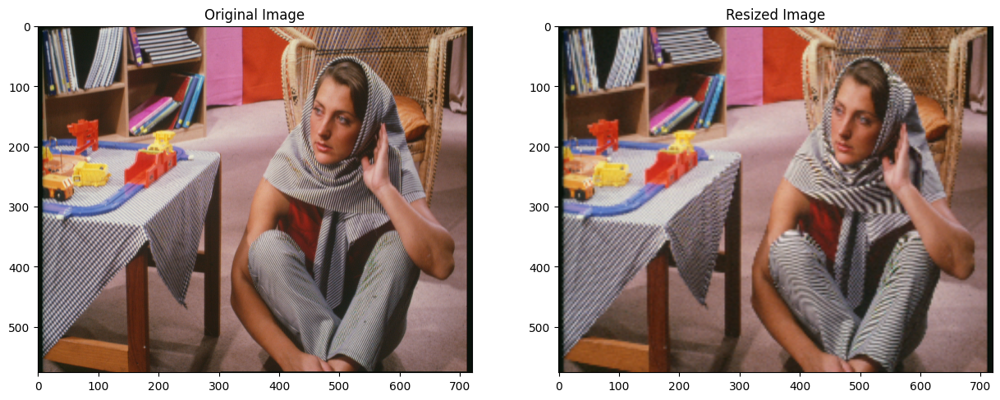

In [30]:
from PIL import Image
fig, ax = plt.subplots(1, 2, figsize=(15, 10))
ax[0].imshow(Image.open('./dataset/SRCNN_dataset/Test/Set14/barbara.bmp'))
ax[0].title.set_text('Original Image')
ax[1].imshow(Image.open('./dataset/SRCNN_dataset/resized/barbara.bmp'))
ax[1].title.set_text('Resized Image')

plt.show()

In [31]:
target = cv2.imread('./dataset/SRCNN_dataset/Test/Set14/barbara.bmp')
ref = cv2.imread('./dataset/SRCNN_dataset/resized/barbara.bmp')

metrics = compare_images(target, ref)
print("PSNR: {}".format(metrics[0]))
print("MSE: {}".format(metrics[1]))
print("SSIM: {}".format(metrics[2]))
#SSIM: 0.9998834134781177

PSNR: 23.447391705229194
MSE: 881.9874267578125
SSIM: 0.9998834134781177



- Kênh sáng (luminance) Y là một trong ba kênh màu trong không gian màu YCrCb. 
- Trong ngữ cảnh của hình ảnh màu, kênh Y biểu thị độ sáng của hình ảnh và đóng góp lớn vào nhìn thấy của mắt người. 
- Các kênh còn lại trong không gian màu này là kênh Cr (đỏ-chìm) và kênh Cb (xanh-chìm), 
- chúng thường đại diện cho các thông tin về màu sắc và độ chìm của hình ảnh.

- Việc giữ lại chỉ kênh Y thường được thực hiện để giảm chiều sâu màu sắc và tập trung chủ yếu vào thông tin về độ sáng,
- Có thể hữu ích trong một số ứng dụng như xử lý ảnh, nhận dạng khuôn mặt, hay nhiều công việc xử lý hình ảnh khác.

## BUILD TRAIN DATASET

In [32]:
# Build train dataset
import h5py

names = sorted(os.listdir('./dataset/SRCNN_dataset/Train'))

data = []
label = []

for name in names:
    fpath = './dataset/SRCNN_dataset/Train/' + name
    hr_img = cv2.imread(fpath, cv2.IMREAD_COLOR)
    hr_img = cv2.cvtColor(hr_img, cv2.COLOR_BGR2YCrCb)
    hr_img = hr_img[:, :, 0] # select Y-channel
    shape = hr_img.shape
    
    # resize operation to produce training data and labels
    lr_img = cv2.resize(hr_img, (int(shape[1] / 2), int(shape[0] / 2)))
    lr_img = cv2.resize(lr_img, (shape[1], shape[0]))
    
    width_range = int((shape[0] - 16 * 2) / 16)
    height_range = int((shape[1] - 16 * 2) / 16)
    
    for k in range(width_range):
        for j in range(height_range):
            x = k * 16
            y = j * 16
            
            hr_patch = hr_img[x: x + 32, y: y + 32]
            lr_patch = lr_img[x: x + 32, y: y + 32]
            
            hr_patch = hr_patch.astype(np.float32) / 255.
            lr_patch = lr_patch.astype(np.float32) / 255.
            
            hr = np.zeros((1, 20, 20), dtype=np.double)
            lr = np.zeros((1, 32, 32), dtype=np.double)
            
            hr[0, :, :] = hr_patch[6:-6, 6: -6]
            lr[0, :, :] = lr_patch
            
            label.append(hr)
            data.append(lr)

data = np.array(data, dtype=np.float32)
label = np.array(label, dtype=np.float32)

In [33]:
with h5py.File('train.h5', 'w') as h:
    h.create_dataset('data', data=data, shape=data.shape)
    h.create_dataset('label', data=label, shape=label.shape)

In [34]:
# Build test dataset

names = sorted(os.listdir('./dataset/SRCNN_dataset/Test/Set14'))
nums = len(names)

data_test = np.zeros((nums * 30, 1, 32, 32), dtype=np.double)
label_test = np.zeros((nums * 30, 1, 20, 20), dtype=np.double)

for i, name in enumerate(names):
    fpath = './dataset/SRCNN_dataset/Test/Set14/' + name
    hr_img = cv2.imread(fpath, cv2.IMREAD_COLOR)
    hr_img = cv2.cvtColor(hr_img, cv2.COLOR_BGR2YCrCb)
    hr_img = hr_img[:, :, 0]
    shape = hr_img.shape
    
    # resize operation to produce training data and labels
    lr_img = cv2.resize(hr_img, (int(shape[1] / 2), int(shape[0] / 2)))
    lr_img = cv2.resize(lr_img, (shape[1], shape[0]))
    
    # Produce random crop
    x = np.random.randint(0, min(shape[0], shape[1]) - 32, 30)
    y = np.random.randint(0, min(shape[0], shape[1]) - 32, 30)
    
    for j in range(30):
        lr_patch = lr_img[x[j]:x[j] + 32, y[j]:y[j] + 32]
        hr_patch = hr_img[x[j]:x[j] + 32, y[j]:y[j] + 32]
        
        lr_patch = lr_patch.astype(np.float32) / 255.
        hr_patch = hr_patch.astype(np.float32) / 255.
        
        data_test[i * 30 + j, 0, :, :] = lr_patch
        label_test[i * 30 + j, 0, :, :] = hr_patch[6: -6, 6: -6]

In [35]:
with h5py.File('test.h5', 'w') as h:
    h.create_dataset('data', data=data_test, shape=data_test.shape)
    h.create_dataset('label', data=label_test, shape=label_test.shape)

In [36]:
def model():
    SRCNN = tf.keras.Sequential(name='SRCNN')
    SRCNN.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(9, 9), 
                                     padding='VALID',
                                     use_bias=True,
                                     input_shape=(None, None, 1),
                                     kernel_initializer='glorot_uniform',
                                     activation='relu'))
    SRCNN.add(tf.keras.layers.Conv2D(filters=64, kernel_size=(3, 3),
                                     padding='SAME',
                                     use_bias=True,
                                     kernel_initializer='glorot_uniform',
                                     activation='relu'))
    SRCNN.add(tf.keras.layers.Conv2D(filters=1, kernel_size=(5, 5),
                                     padding='VALID',
                                     use_bias=True,
                                     kernel_initializer='glorot_uniform',
                                     activation='linear'))
    # Optimizer
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.0003)
    
    # Compile model
    SRCNN.compile(optimizer=optimizer, loss='mean_squared_error', metrics=['mean_squared_error'])
    
    return SRCNN

In [37]:
srcnn_model = model()
srcnn_model.summary()

Model: "SRCNN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, None, None, 128)   10496     
                                                                 
 conv2d_4 (Conv2D)           (None, None, None, 64)    73792     
                                                                 
 conv2d_5 (Conv2D)           (None, None, None, 1)     1601      
                                                                 
Total params: 85889 (335.50 KB)
Trainable params: 85889 (335.50 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [38]:
with h5py.File('./train.h5', 'r') as h:
    data = np.array(h.get('data'))
    label = np.array(h.get('label'))
    X_train = np.transpose(data, (0, 2, 3, 1))
    y_train = np.transpose(label, (0, 2, 3, 1))
    
with h5py.File('./test.h5', 'r') as h:
    data = np.array(h.get('data'))
    label = np.array(h.get('label'))
    X_test = np.transpose(data, (0, 2, 3, 1))
    y_test = np.transpose(label, (0, 2, 3, 1))
    
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((14901, 32, 32, 1), (14901, 20, 20, 1), (420, 32, 32, 1), (420, 20, 20, 1))

In [39]:
checkpoint_path = './srcnn/cp-{epoch:04d}.ckpt'
checkpoint_dir = os.path.dirname(checkpoint_path)
checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_dir, save_best_only=True,
                                                 save_weights_only=True, verbose=0)

In [40]:
srcnn_model.fit(X_train, y_train, batch_size=64, validation_data=(X_test, y_test), 
                callbacks=[checkpoint], shuffle=True, epochs=40, verbose=False)

# RESIZE IMAGE

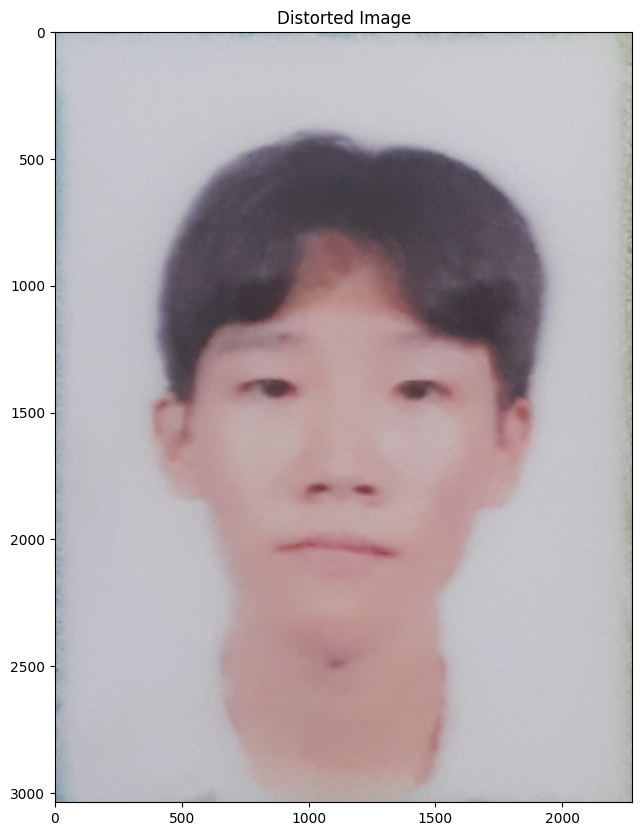

In [41]:
try:
    os.listdir('./dataset/SRCNN_dataset/output')
except:
    os.mkdir('./dataset/SRCNN_dataset/output')

list_img = os.listdir('./Validation/')

target = cv2.imread('./dataset/SRCNN_dataset/Test/Set14/barbara.bmp', cv2.IMREAD_COLOR)
for i in range(len(list_img)):
    target_path = './Validation/'+list_img[i]
    target = cv2.imread(target_path, cv2.IMREAD_COLOR)
    target = cv2.cvtColor(target, cv2.COLOR_BGR2YCrCb)
    shape = target.shape

    # Resize down by scale of 2
    Y_img = cv2.resize(target[:, :, 0], (int(shape[1] / 3), int(shape[0] / 3)), cv2.INTER_CUBIC)

    # Resize up to orignal image
    Y_img = cv2.resize(Y_img, (shape[1], shape[0]), cv2.INTER_CUBIC)
    target[:, :, 0] = Y_img
    target = cv2.cvtColor(target, cv2.COLOR_YCrCb2BGR)
    out_path = './dataset/SRCNN_dataset/input/input'+str(i)+'.jpg'
    cv2.imwrite(out_path, target)

fig, ax = plt.subplots(figsize=(15, 10))
ax.imshow(Image.open('./dataset/SRCNN_dataset/input/input3.jpg'))
ax.title.set_text("Distorted Image")
plt.show()

# PREDICT IMAGE FROM MODEL

In [44]:
try:
    os.listdir('./dataset/SRCNN_dataset/demo')
except:
    os.mkdir('./dataset/SRCNN_dataset/demo')

target = cv2.imread('./dataset/SRCNN_dataset/Test/Set14/barbara.bmp', cv2.IMREAD_COLOR)
target = cv2.cvtColor(target, cv2.COLOR_BGR2YCrCb)
shape = target.shape

# Resize down by scale of 2
Y_img = cv2.resize(target[:, :, 0], (int(shape[1] / 2), int(shape[0] / 2)), cv2.INTER_CUBIC)

# Resize up to orignal image
Y_img = cv2.resize(Y_img, (shape[1], shape[0]), cv2.INTER_CUBIC)
target[:, :, 0] = Y_img
target = cv2.cvtColor(target, cv2.COLOR_YCrCb2BGR)
cv2.imwrite('./dataset/SRCNN_dataset/demo/input.jpg', target)

Y = np.zeros((1, target.shape[0], target.shape[1], 1), dtype=np.float32)
# Normalize
Y[0, :, :, 0] = Y_img.astype(np.float32) / 255.

# Predict
pre = srcnn_model.predict(Y, batch_size=1) * 255.

# Post process output
pre[pre[:] > 255] = 255
pre[pre[:] < 0] = 0
pre = pre.astype(np.uint8)

# Copy y channel back to image and convert to BGR
output = cv2.cvtColor(target, cv2.COLOR_BGR2YCrCb)
output[6: -6, 6: -6, 0] = pre[0, :, :, 0]
output = cv2.cvtColor(output, cv2.COLOR_YCrCb2BGR)

# Save image
cv2.imwrite('./dataset/SRCNN_dataset/demo/output.jpg', output)

1/1 [==============================] - 1s 501ms/step


True

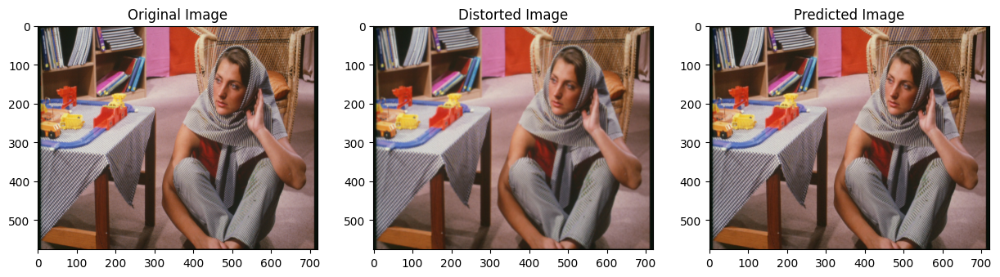

In [45]:
fig, ax = plt.subplots(1, 3, figsize=(15, 10))
ax[0].imshow(Image.open('./dataset/SRCNN_dataset/Test/Set14/barbara.bmp'))
ax[0].title.set_text("Original Image")

ax[1].imshow(Image.open('./dataset/SRCNN_dataset/demo/input.jpg'))
ax[1].title.set_text("Distorted Image")

ax[2].imshow(Image.open('./dataset/SRCNN_dataset/demo/output.jpg'))
ax[2].title.set_text("Predicted Image")

# CHẠY MODEL VỚI TẬP VALIDATION

In [46]:
path_input = './Validation/'

for i in range(len(list_img)):
    input_path = path_input +  list_img[i]
    target = cv2.imread(input_path, cv2.IMREAD_COLOR)
    target = cv2.cvtColor(target, cv2.COLOR_BGR2YCrCb)
    shape = target.shape

    # Resize down by scale of 2
    Y_img = cv2.resize(target[:, :, 0], (int(shape[1] / 2), int(shape[0] / 2)), cv2.INTER_CUBIC)

    # Resize up to orignal image
    Y_img = cv2.resize(Y_img, (shape[1], shape[0]), cv2.INTER_CUBIC)
    target[:, :, 0] = Y_img
    target = cv2.cvtColor(target, cv2.COLOR_YCrCb2BGR)


    Y = np.zeros((1, target.shape[0], target.shape[1], 1), dtype=np.float32)
    # Normalize
    Y[0, :, :, 0] = Y_img.astype(np.float32) / 255.

    # Predict
    pre = srcnn_model.predict(Y, batch_size=1) * 255.

    # Post process output
    pre[pre[:] > 255] = 255
    pre[pre[:] < 0] = 0
    pre = pre.astype(np.uint8)

    # Copy y channel back to image and convert to BGR
    output = cv2.cvtColor(target, cv2.COLOR_BGR2YCrCb)
    output[6: -6, 6: -6, 0] = pre[0, :, :, 0]
    output = cv2.cvtColor(output, cv2.COLOR_YCrCb2BGR)

    # Save image
    output_path = './dataset/SRCNN_dataset/output/output' + str(i)
    output_path = output_path + '.jpg'
    # output_path = './dataset/SRCNN_dataset/output/output'.join(str(i),'.jpg')
    cv2.imwrite(output_path, output)

    # fig, ax = plt.subplots(figsize=(15, 10))
    # ax.imshow(Image.open('./dataset/SRCNN_dataset/output/output.jpg'))
    # ax.title.set_text("Predicted Image")
    # plt.show()

         

1/1 [==============================] - 1s 531ms/step


C:\Users\TAN\AppData\Local\Temp\ipykernel_5340\927250158.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 2, figsize=(20, 10))


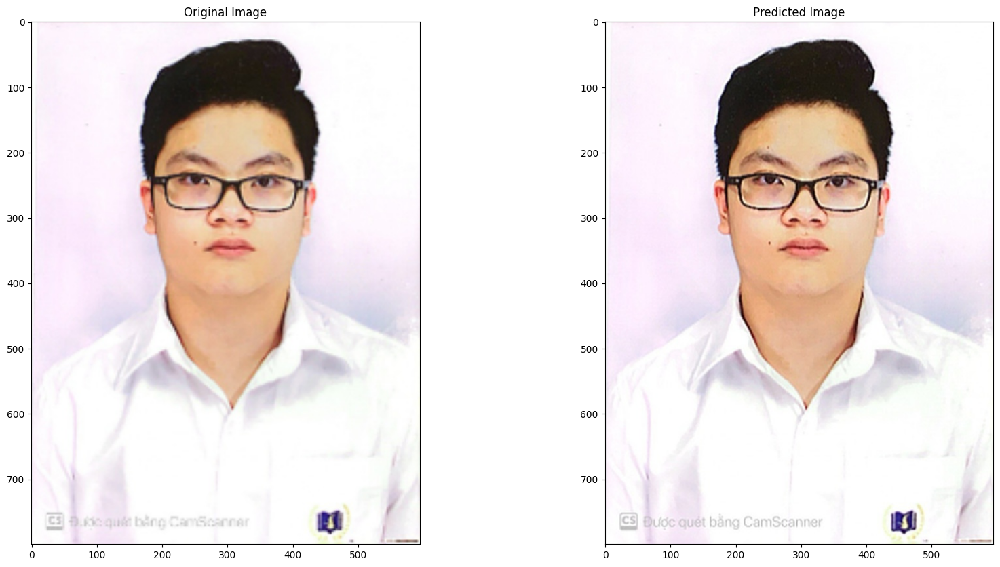

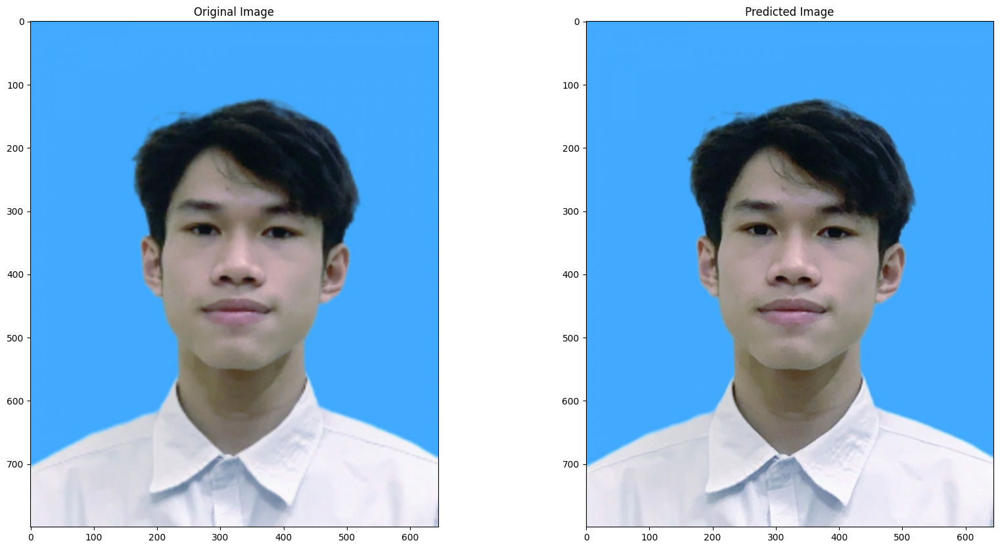

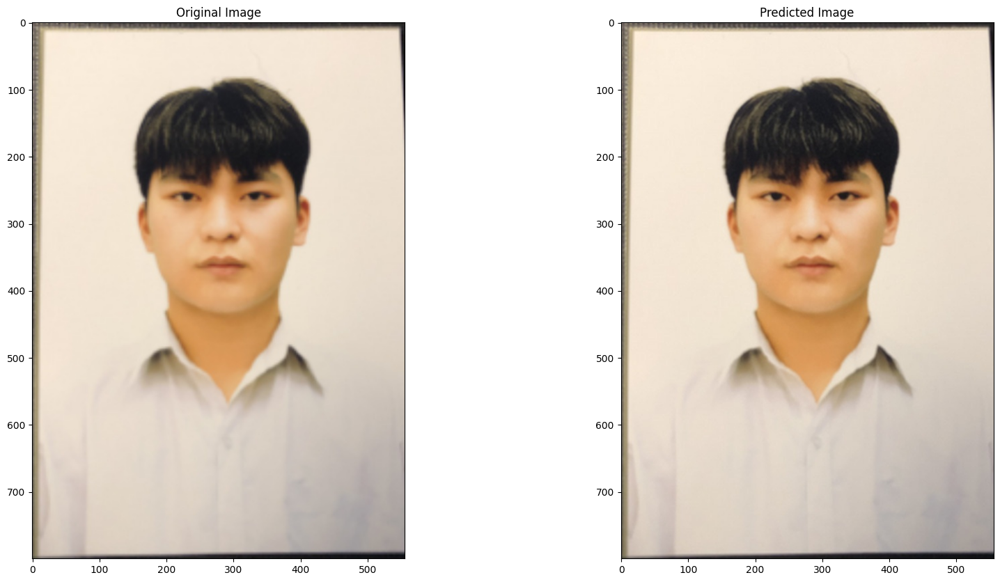

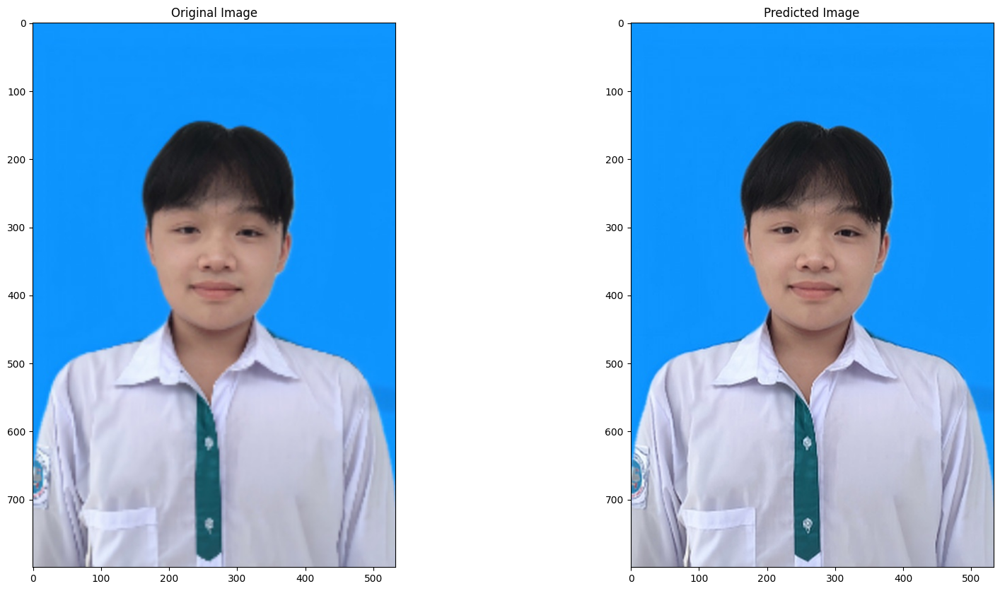

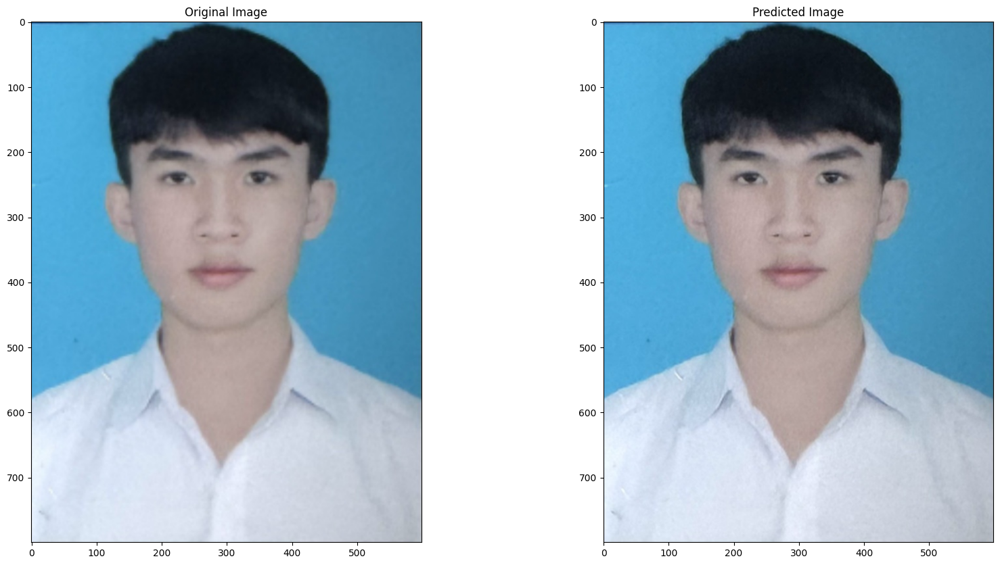

...

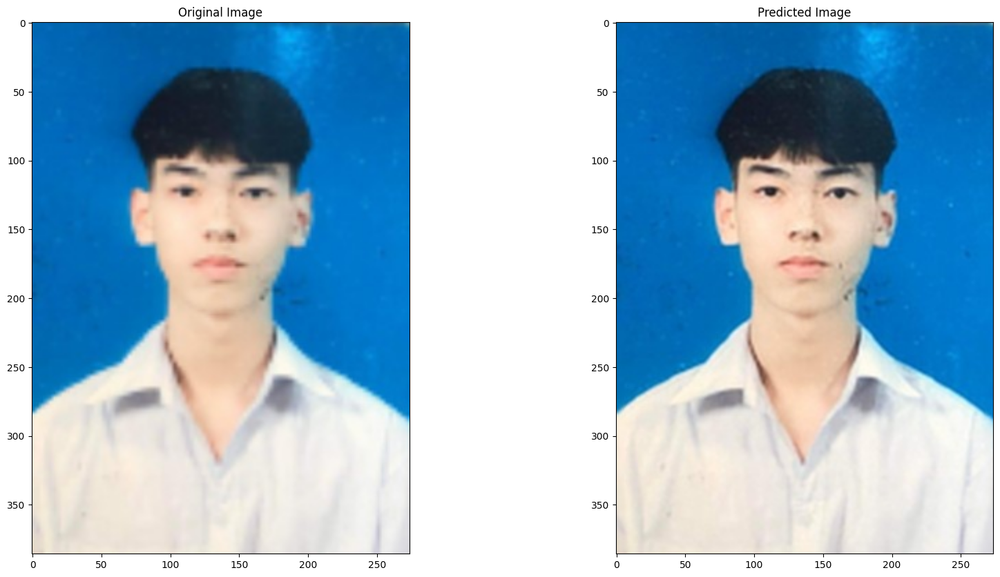

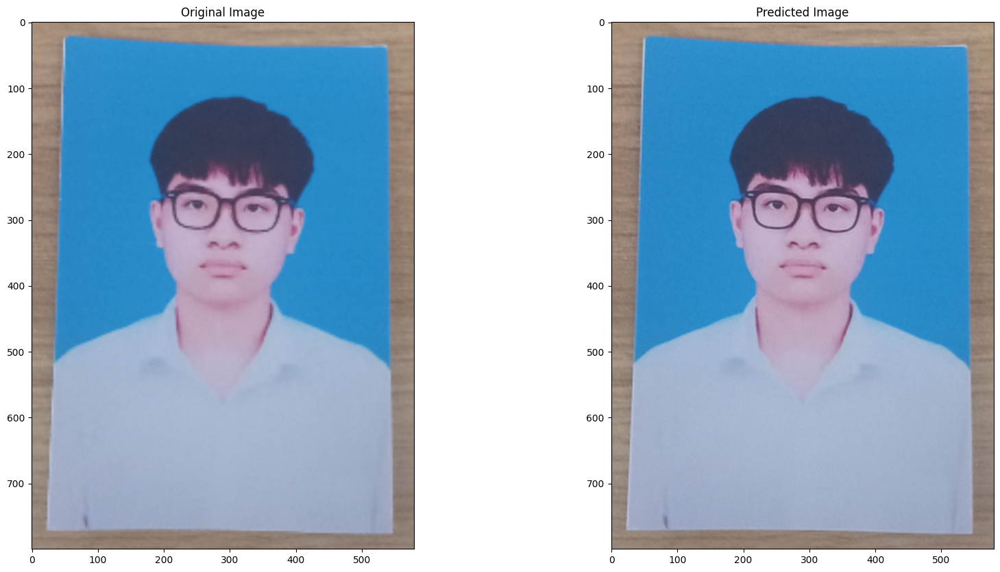

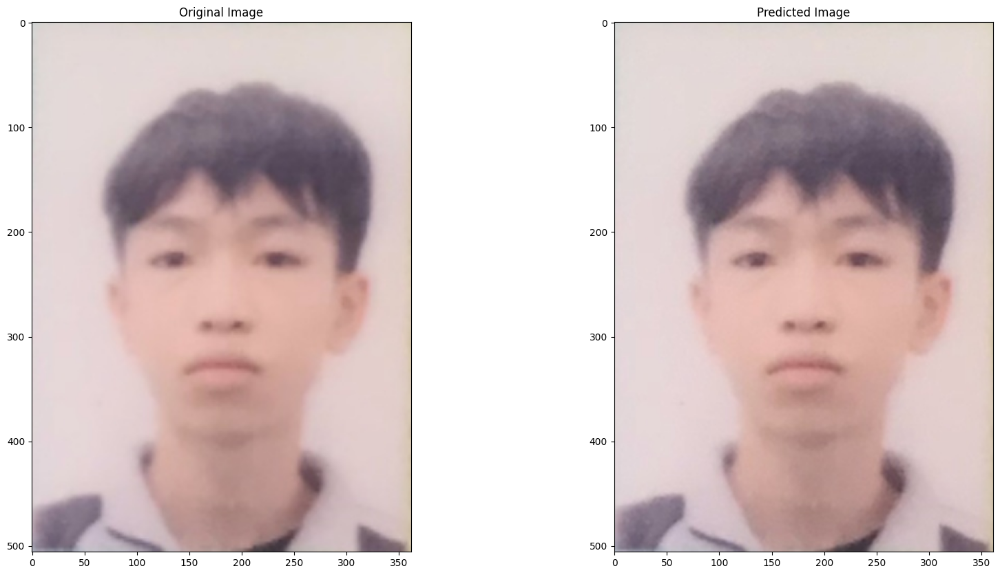

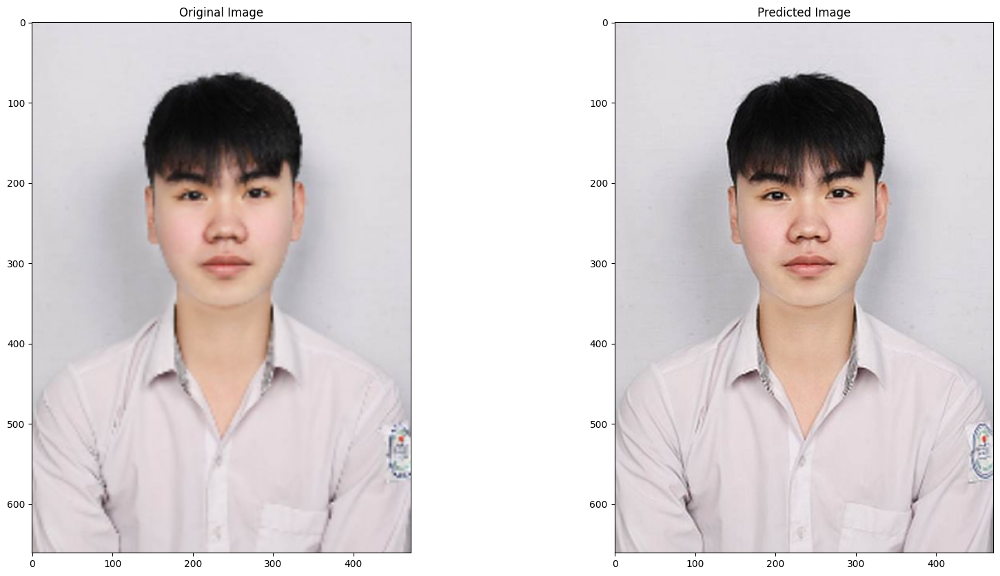

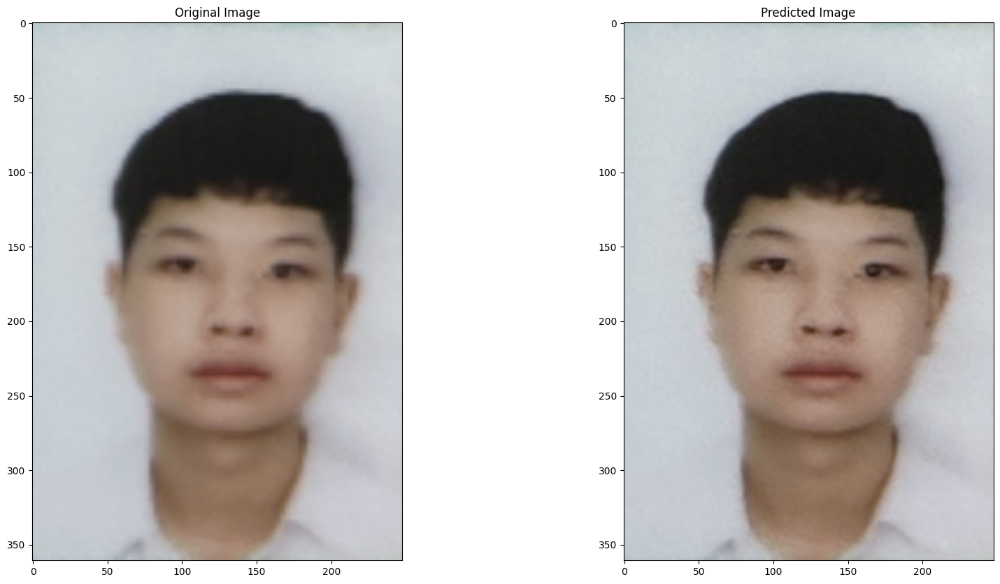

In [59]:
input_path = './dataset/SRCNN_dataset/input/'
list_input = os.listdir(input_path)
output_path = './dataset/SRCNN_dataset/output/'
list_output = os.listdir(output_path)
for i in range(len(list_img)):
    # input_path = path + list_input[i]
    input = input_path + list_input[i]
    output = output_path + list_output[i]
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].imshow(Image.open(input))
    ax[0].title.set_text("Original Image")
    # ax[1].imshow(Image.open('./dataset/SRCNN_dataset/output/output.jpg'))
    ax[1].imshow(Image.open(output))
    ax[1].title.set_text("Predicted Image")